<a href="https://colab.research.google.com/github/Purple-Catt/DM1-Project/blob/master/Hierarchical_clustering_v3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

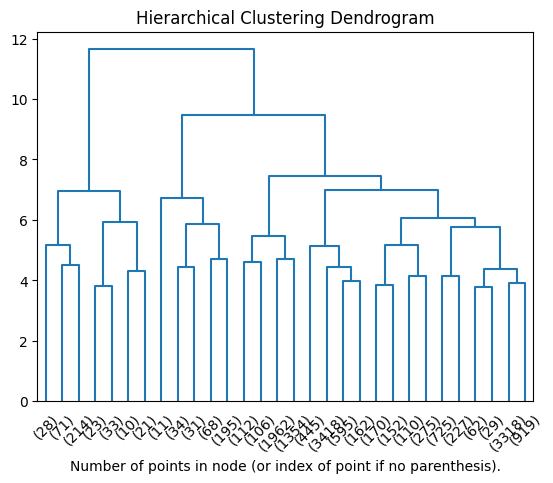

Silhouette 0.07804734070465023


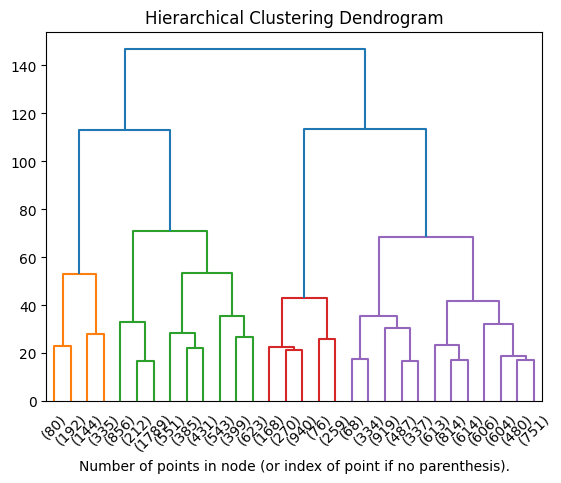

labels {0: 751, 1: 4482, 2: 1713, 3: 1565, 4: 2857, 5: 2145, 6: 1367}
silhouette 0.15741668160040256
average linkage
labels {0: 14827, 1: 10, 2: 29, 3: 2, 4: 10, 5: 1, 6: 1}
silhouette 0.45887020236610376
complete linkage
labels {0: 11507, 1: 674, 2: 1187, 3: 222, 4: 2, 5: 1284, 6: 4}
silhouette -0.020342730294162555


In [4]:
##### 7 cluster senza MinMaxScaler #####

import numpy as np
import pandas as pd
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from matplotlib import pyplot as plt
import seaborn as sns
from scipy.spatial.distance import pdist, squareform
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import *
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.neighbors import kneighbors_graph


df = pd.read_csv("/content/drive/MyDrive/Università/Magistrale/Data Mining/dataset (missing + split)/clustering_dataset.csv") # read the data
train_data = df.drop(['Unnamed: 0'], axis=1) # drop the first column
df_train = train_data.copy()

#df_train = df.drop(['Unnamed: 0'], axis=1) # drop the first column
#scaler = MinMaxScaler()
#train_data = scaler.fit_transform(df_train)

def get_linkage_matrix(model):
    # Create linkage matrix

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    return linkage_matrix

def plot_dendrogram(model, **kwargs):
    linkage_matrix = get_linkage_matrix(model)
    dendrogram(linkage_matrix, **kwargs)

# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(distance_threshold=0, n_clusters=None, metric='euclidean', linkage='complete')
model = model.fit(train_data)

plt.title("Hierarchical Clustering Dendrogram")
plot_dendrogram(model, truncate_mode="lastp", color_threshold=1.2)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

# get the labels according to a specific threshold value cut
Z = get_linkage_matrix(model)
labels = fcluster(Z, t=1.2, criterion='distance')
labels

print('Silhouette', silhouette_score(train_data, labels))

#hier = AgglomerativeClustering(n_clusters=3, metric='euclidean', linkage='complete')
#hier.fit(train_data)


# hierarchical clustering
# Compute the (weighted) graph of k-Neighbors for points in X
connectivity = kneighbors_graph(train_data, n_neighbors=100, include_self=False)

# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(distance_threshold=0,
                                n_clusters=None,
                                metric='euclidean',
                                linkage='ward',
                                connectivity=connectivity)

# connecet: Defines for each sample the neighboring
# samples following a given structure of the data.

model = model.fit(train_data)

plt.title("Hierarchical Clustering Dendrogram")
plot_dendrogram(model, truncate_mode="lastp")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()
############ n_cluster???????
ward = AgglomerativeClustering(n_clusters=7,
                               linkage='ward',
                               metric='euclidean',
                               connectivity=connectivity)
ward.fit(train_data)

hist, bins = np.histogram(ward.labels_, bins=range(0, len(set(ward.labels_)) + 1))
print('labels', dict(zip(bins, hist)))
print('silhouette WARD', silhouette_score(train_data, ward.labels_))

print('average linkage')
average_linkage = AgglomerativeClustering(n_clusters=7, linkage='average', metric='manhattan',  connectivity=connectivity)
average_linkage.fit(train_data)

hist, bins = np.histogram(average_linkage.labels_,
                          bins=range(0, len(set(average_linkage.labels_)) + 1))

print('labels', dict(zip(bins, hist)))
print('silhouette', silhouette_score(train_data, average_linkage.labels_))


print('complete linkage')
complete_linkage = AgglomerativeClustering(n_clusters=7, linkage='complete', metric='l1', connectivity=connectivity)
complete_linkage.fit(train_data)

hist, bins = np.histogram(complete_linkage.labels_,
                          bins=range(0, len(set(complete_linkage.labels_)) + 1))

print('labels', dict(zip(bins, hist)))
print('silhouette', silhouette_score(train_data, complete_linkage.labels_))



#grafico a linee orizzontali
cluster_labels = ward.labels_

# Plot the cluster centers
plt.figure(figsize=(20, 6))
n_clusters = 7
for i in range(n_clusters):
    plt.plot(range(0, len(df_train.columns)), df_train.iloc[cluster_labels == i].mean(), label='Cluster %s' % i, linewidth=3)

plt.xticks(range(0, len(df_train.columns)), list(df_train.columns))
plt.legend(bbox_to_anchor=(1, 1))
plt.grid(axis='y')
plt.show()

# Pairplot
df_clusters = df_train.copy()
df_clusters['Labels'] = ward.labels_

# Utilizza seaborn per visualizzare il pairplot con Hue sui valori di Ward
sns.pairplot(df_clusters, hue='Labels', palette='bright')
plt.show()

#scatterplot
#df_clusters = df_train.copy()
#df_clusters['Labels'] = ward.labels_
#for i in range(len(df_clusters.columns)):
#    for j in range(i + 1, len(df_clusters.columns)):
#        sns.scatterplot(data=df_clusters, x=df_clusters.columns[i], y=df_clusters.columns[j], hue=ward.labels_, style=ward.labels_, palette="bright")
#        plt.show()


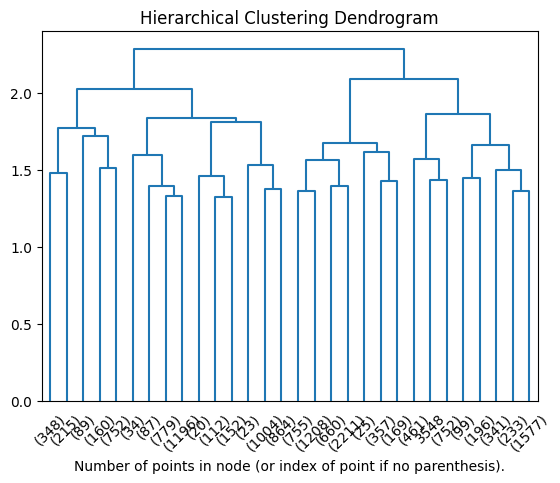

Silhouette 0.05444278650407162


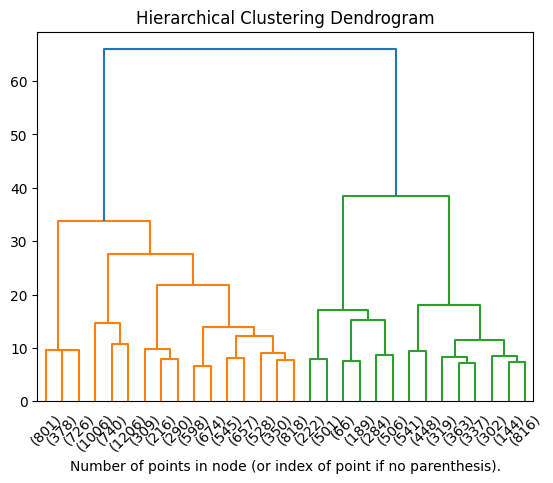

labels {0: 1768, 1: 2952, 2: 2281, 3: 1905, 4: 4170, 5: 815, 6: 989}
silhouette WARD 0.17057434280182007
average linkage
labels {0: 14862, 1: 9, 2: 3, 3: 1, 4: 1, 5: 1, 6: 3}
silhouette 0.13046143816937655
complete linkage
labels {0: 1257, 1: 2822, 2: 7820, 3: 1, 4: 1973, 5: 298, 6: 709}
silhouette -0.027189967874950902


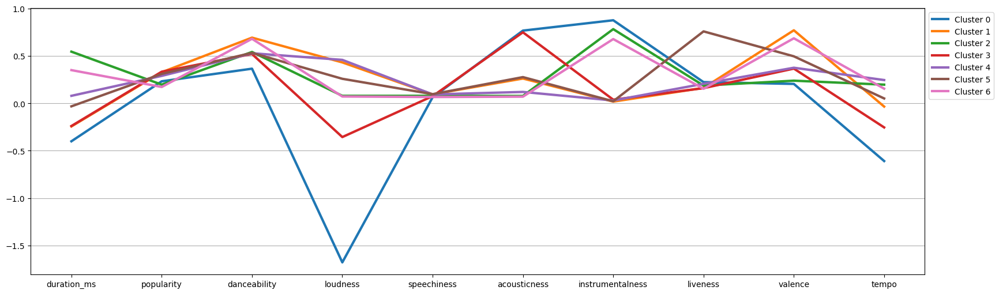

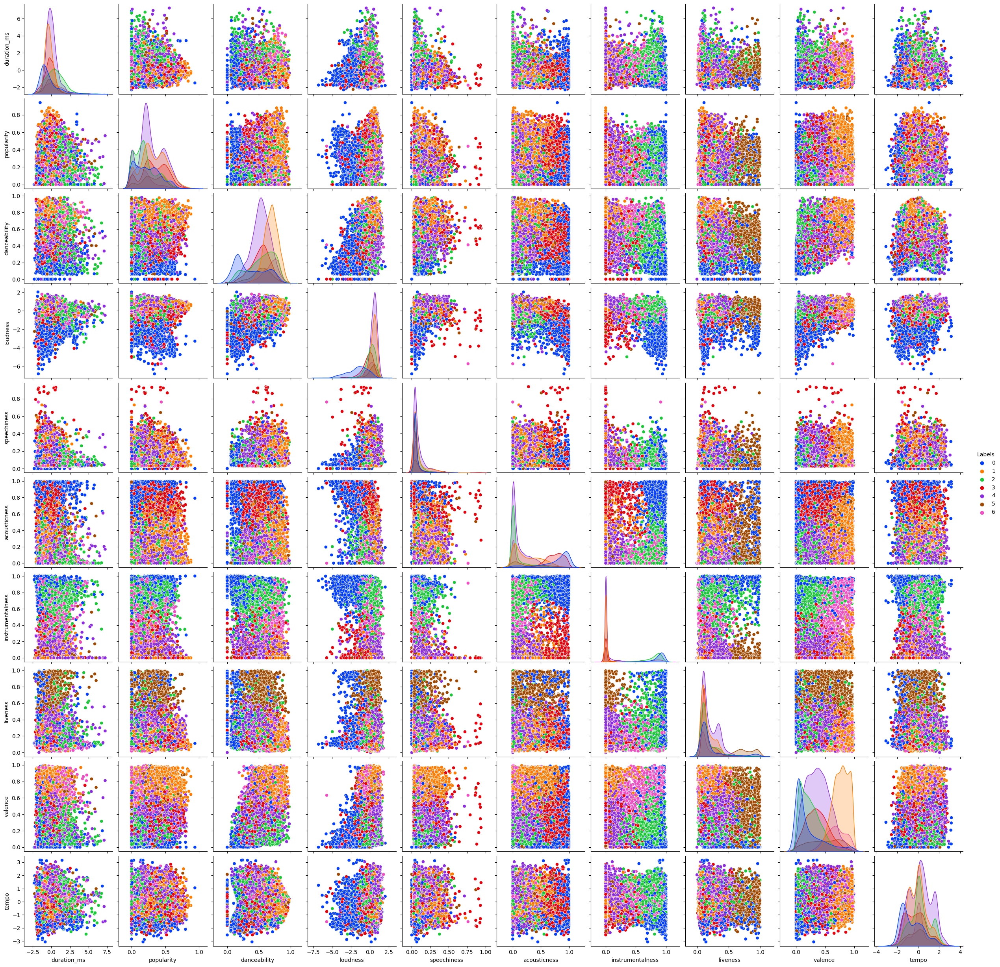

In [23]:
##### 7 cluster con MinMaxScaler #####

import numpy as np
import pandas as pd
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from matplotlib import pyplot as plt
import seaborn as sns
from scipy.spatial.distance import pdist, squareform
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import *
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.neighbors import kneighbors_graph


df = pd.read_csv("/content/drive/MyDrive/Università/Magistrale/Data Mining/dataset (missing + split)/clustering_dataset.csv") # read the data
#train_data = df.drop(['Unnamed: 0'], axis=1) # drop the first column

df_train = df.drop(['Unnamed: 0'], axis=1) # drop the first column
scaler = MinMaxScaler()
train_data = scaler.fit_transform(df_train)

def get_linkage_matrix(model):
    # Create linkage matrix

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    return linkage_matrix

def plot_dendrogram(model, **kwargs):
    linkage_matrix = get_linkage_matrix(model)
    dendrogram(linkage_matrix, **kwargs)

# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(distance_threshold=0, n_clusters=None, metric='euclidean', linkage='complete')
model = model.fit(train_data)

plt.title("Hierarchical Clustering Dendrogram")
plot_dendrogram(model, truncate_mode="lastp", color_threshold=1.2)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

# get the labels according to a specific threshold value cut
Z = get_linkage_matrix(model)
labels = fcluster(Z, t=1.2, criterion='distance')
labels

print('Silhouette', silhouette_score(train_data, labels))

#hier = AgglomerativeClustering(n_clusters=3, metric='euclidean', linkage='complete')
#hier.fit(train_data)


# hierarchical clustering
# Compute the (weighted) graph of k-Neighbors for points in X
connectivity = kneighbors_graph(train_data, n_neighbors=100, include_self=False)

# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(distance_threshold=0,
                                n_clusters=None,
                                metric='euclidean',
                                linkage='ward',
                                connectivity=connectivity)

# connecet: Defines for each sample the neighboring
# samples following a given structure of the data.

model = model.fit(train_data)

plt.title("Hierarchical Clustering Dendrogram")
plot_dendrogram(model, truncate_mode="lastp")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()
############ n_cluster???????
ward = AgglomerativeClustering(n_clusters=7,
                               linkage='ward',
                               metric='euclidean',
                               connectivity=connectivity)
ward.fit(train_data)

hist, bins = np.histogram(ward.labels_, bins=range(0, len(set(ward.labels_)) + 1))
print('labels', dict(zip(bins, hist)))
print('silhouette WARD', silhouette_score(train_data, ward.labels_))

print('average linkage')
average_linkage = AgglomerativeClustering(n_clusters=7, linkage='average', metric='manhattan',  connectivity=connectivity)
average_linkage.fit(train_data)

hist, bins = np.histogram(average_linkage.labels_,
                          bins=range(0, len(set(average_linkage.labels_)) + 1))

print('labels', dict(zip(bins, hist)))
print('silhouette', silhouette_score(train_data, average_linkage.labels_))


print('complete linkage')
complete_linkage = AgglomerativeClustering(n_clusters=7, linkage='complete', metric='l1', connectivity=connectivity)
complete_linkage.fit(train_data)

hist, bins = np.histogram(complete_linkage.labels_,
                          bins=range(0, len(set(complete_linkage.labels_)) + 1))

print('labels', dict(zip(bins, hist)))
print('silhouette', silhouette_score(train_data, complete_linkage.labels_))



#grafico a linee orizzontali
cluster_labels = ward.labels_

# Plot the cluster centers
plt.figure(figsize=(20, 6))
n_clusters = 7
for i in range(n_clusters):
    plt.plot(range(0, len(df_train.columns)), df_train.iloc[cluster_labels == i].mean(), label='Cluster %s' % i, linewidth=3)

plt.xticks(range(0, len(df_train.columns)), list(df_train.columns))
plt.legend(bbox_to_anchor=(1, 1))
plt.grid(axis='y')
plt.show()

# Pairplot
df_clusters = df_train.copy()
df_clusters['Labels'] = ward.labels_

# Utilizza seaborn per visualizzare il pairplot con Hue sui valori di Ward
sns.pairplot(df_clusters, hue='Labels', palette='bright')
plt.show()

#scatterplot
#df_clusters = df_train.copy()
#df_clusters['Labels'] = ward.labels_
#for i in range(len(df_clusters.columns)):
#    for j in range(i + 1, len(df_clusters.columns)):
#        sns.scatterplot(data=df_clusters, x=df_clusters.columns[i], y=df_clusters.columns[j], hue=ward.labels_, style=ward.labels_, palette="bright")
#        plt.show()


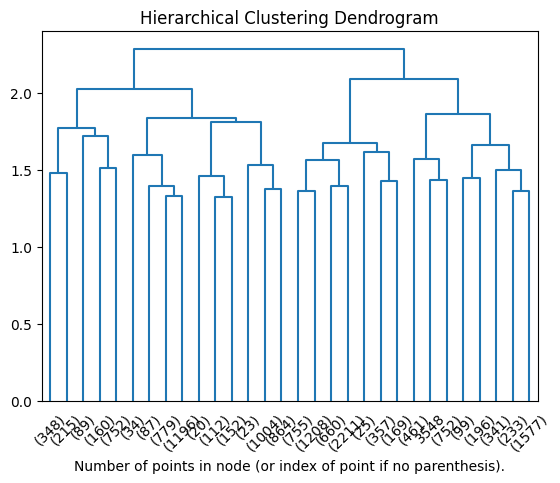

Silhouette 0.05444278650407162


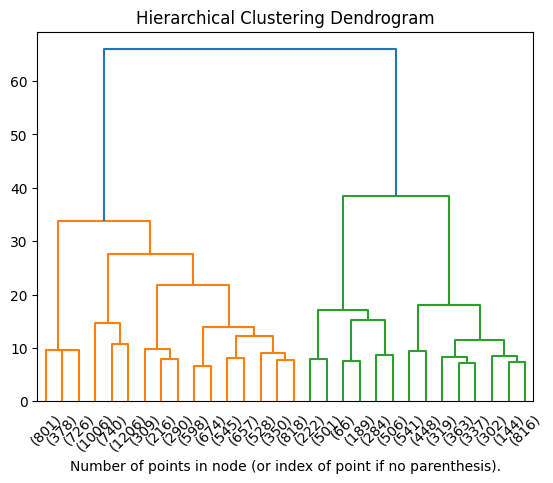

labels {0: 4985, 1: 3270, 2: 1768, 3: 1905, 4: 2952}
silhouette WARD 0.18421650146277588
average linkage
labels {0: 14868, 1: 9, 2: 1, 3: 1, 4: 1}
silhouette 0.16408409727377116
complete linkage
labels {0: 1007, 1: 1257, 2: 10642, 3: 1, 4: 1973}
silhouette -0.02404570720359294


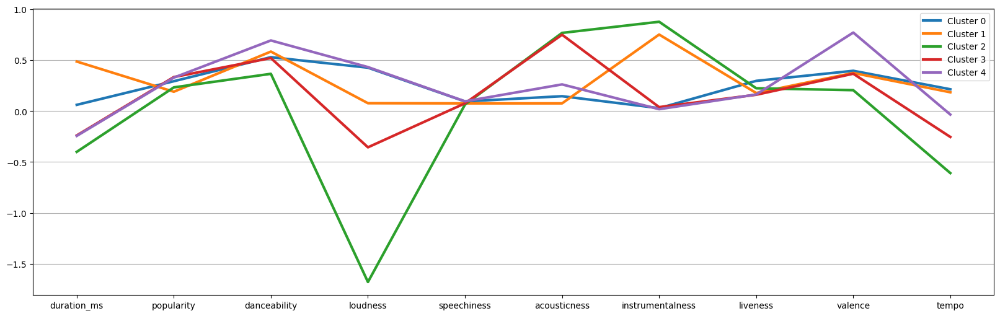

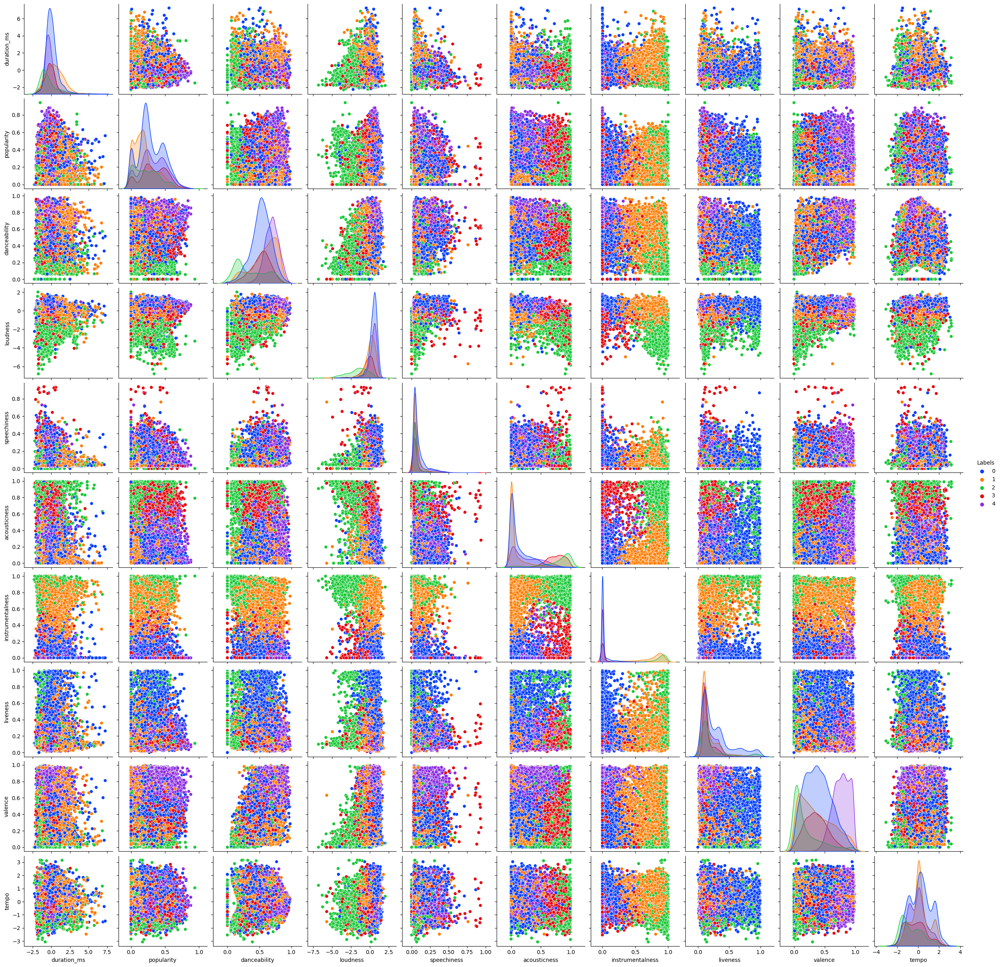

In [22]:
##### 5 cluster con MinMaxScaler #####

import numpy as np
import pandas as pd
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from matplotlib import pyplot as plt
import seaborn as sns
from scipy.spatial.distance import pdist, squareform
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import *
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.neighbors import kneighbors_graph


df = pd.read_csv("/content/drive/MyDrive/Università/Magistrale/Data Mining/dataset (missing + split)/clustering_dataset.csv") # read the data
#train_data = df.drop(['Unnamed: 0'], axis=1) # drop the first column

df_train = df.drop(['Unnamed: 0'], axis=1) # drop the first column
scaler = MinMaxScaler()
train_data = scaler.fit_transform(df_train)

def get_linkage_matrix(model):
    # Create linkage matrix

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    return linkage_matrix

def plot_dendrogram(model, **kwargs):
    linkage_matrix = get_linkage_matrix(model)
    dendrogram(linkage_matrix, **kwargs)

# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(distance_threshold=0, n_clusters=None, metric='euclidean', linkage='complete')
model = model.fit(train_data)

plt.title("Hierarchical Clustering Dendrogram")
plot_dendrogram(model, truncate_mode="lastp", color_threshold=1.2)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

# get the labels according to a specific threshold value cut
Z = get_linkage_matrix(model)
labels = fcluster(Z, t=1.2, criterion='distance')
labels

print('Silhouette', silhouette_score(train_data, labels))

#hier = AgglomerativeClustering(n_clusters=3, metric='euclidean', linkage='complete')
#hier.fit(train_data)


# hierarchical clustering
# Compute the (weighted) graph of k-Neighbors for points in X
connectivity = kneighbors_graph(train_data, n_neighbors=100, include_self=False)

# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(distance_threshold=0,
                                n_clusters=None,
                                metric='euclidean',
                                linkage='ward',
                                connectivity=connectivity)

# connecet: Defines for each sample the neighboring
# samples following a given structure of the data.

model = model.fit(train_data)

plt.title("Hierarchical Clustering Dendrogram")
plot_dendrogram(model, truncate_mode="lastp")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()
############ n_cluster???????
ward = AgglomerativeClustering(n_clusters=5,
                               linkage='ward',
                               metric='euclidean',
                               connectivity=connectivity)
ward.fit(train_data)

hist, bins = np.histogram(ward.labels_, bins=range(0, len(set(ward.labels_)) + 1))
print('labels', dict(zip(bins, hist)))
print('silhouette WARD', silhouette_score(train_data, ward.labels_))

print('average linkage')
average_linkage = AgglomerativeClustering(n_clusters=5, linkage='average', metric='manhattan',  connectivity=connectivity)
average_linkage.fit(train_data)

hist, bins = np.histogram(average_linkage.labels_,
                          bins=range(0, len(set(average_linkage.labels_)) + 1))

print('labels', dict(zip(bins, hist)))
print('silhouette', silhouette_score(train_data, average_linkage.labels_))


print('complete linkage')
complete_linkage = AgglomerativeClustering(n_clusters=5, linkage='complete', metric='l1', connectivity=connectivity)
complete_linkage.fit(train_data)

hist, bins = np.histogram(complete_linkage.labels_,
                          bins=range(0, len(set(complete_linkage.labels_)) + 1))

print('labels', dict(zip(bins, hist)))
print('silhouette', silhouette_score(train_data, complete_linkage.labels_))



#grafico a linee orizzontali
cluster_labels = ward.labels_

# Plot the cluster centers
plt.figure(figsize=(20, 6))
n_clusters = 5
for i in range(n_clusters):
    plt.plot(range(0, len(df_train.columns)), df_train.iloc[cluster_labels == i].mean(), label='Cluster %s' % i, linewidth=3)

plt.xticks(range(0, len(df_train.columns)), list(df_train.columns))
plt.legend(bbox_to_anchor=(1, 1))
plt.grid(axis='y')
plt.show()

# Pairplot
df_clusters = df_train.copy()
df_clusters['Labels'] = ward.labels_

# Utilizza seaborn per visualizzare il pairplot con Hue sui valori di Ward
sns.pairplot(df_clusters, hue='Labels', palette='bright')
plt.show()

#scatterplot
#df_clusters = df_train.copy()
#df_clusters['Labels'] = ward.labels_
#for i in range(len(df_clusters.columns)):
#    for j in range(i + 1, len(df_clusters.columns)):
#        sns.scatterplot(data=df_clusters, x=df_clusters.columns[i], y=df_clusters.columns[j], hue=ward.labels_, style=ward.labels_, palette="bright")
#        plt.show()


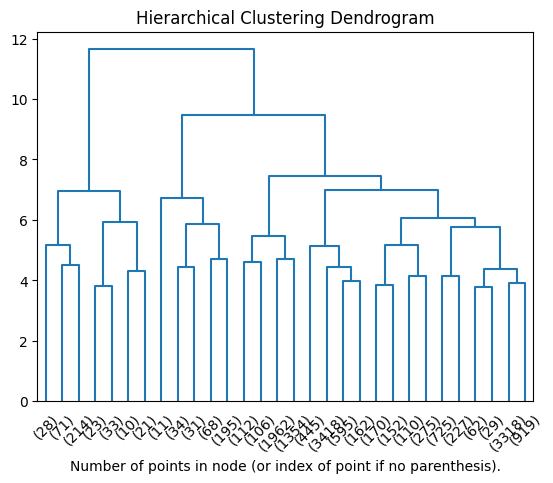

Silhouette 0.07804734070465023


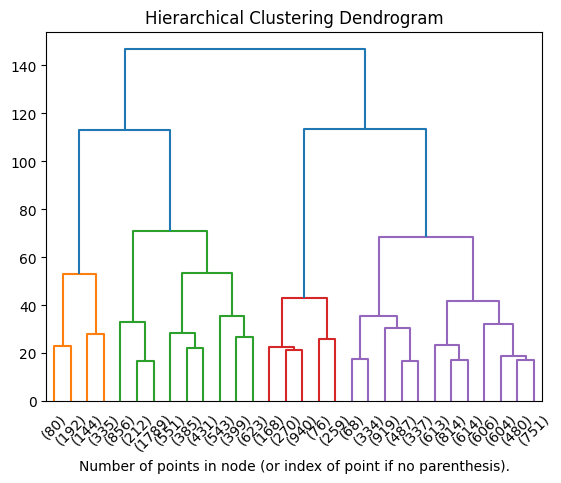

labels {0: 6627, 1: 2932, 2: 1713, 3: 751, 4: 2857}
silhouette WARD 0.17534639964263327
average linkage
labels {0: 14857, 1: 10, 2: 1, 3: 2, 4: 10}
silhouette 0.4689450361870128
complete linkage
labels {0: 12694, 1: 674, 2: 1288, 3: 222, 4: 2}
silhouette -0.011697049301666262


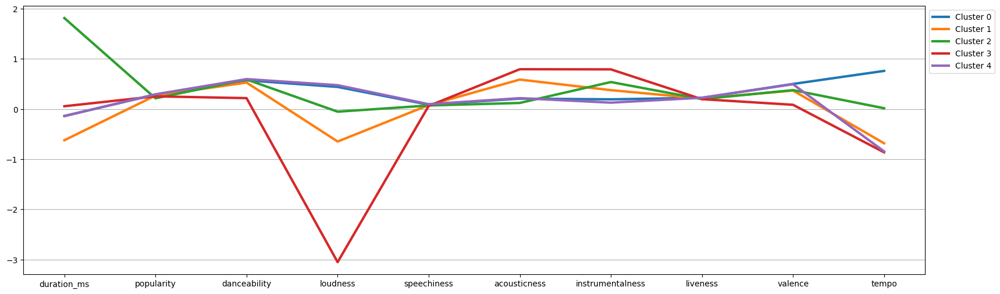

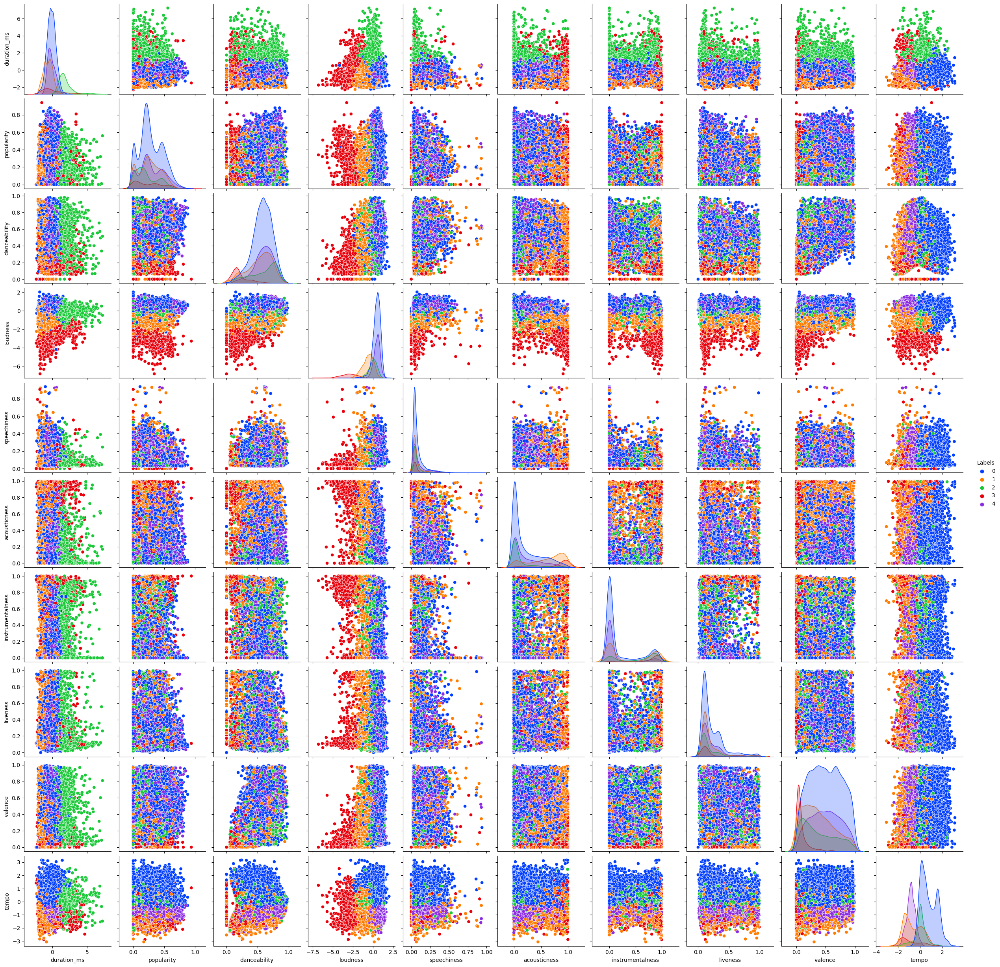

In [21]:
##### 5 cluster senza MinMaxScaler #####

import numpy as np
import pandas as pd
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from matplotlib import pyplot as plt
import seaborn as sns
from scipy.spatial.distance import pdist, squareform
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import *
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.neighbors import kneighbors_graph


df = pd.read_csv("/content/drive/MyDrive/Università/Magistrale/Data Mining/dataset (missing + split)/clustering_dataset.csv") # read the data
train_data = df.drop(['Unnamed: 0'], axis=1) # drop the first column

#df_train = df.drop(['Unnamed: 0'], axis=1) # drop the first column
#scaler = MinMaxScaler()
#train_data = scaler.fit_transform(df_train)

def get_linkage_matrix(model):
    # Create linkage matrix

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    return linkage_matrix

def plot_dendrogram(model, **kwargs):
    linkage_matrix = get_linkage_matrix(model)
    dendrogram(linkage_matrix, **kwargs)

# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(distance_threshold=0, n_clusters=None, metric='euclidean', linkage='complete')
model = model.fit(train_data)

plt.title("Hierarchical Clustering Dendrogram")
plot_dendrogram(model, truncate_mode="lastp", color_threshold=1.2)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

# get the labels according to a specific threshold value cut
Z = get_linkage_matrix(model)
labels = fcluster(Z, t=1.2, criterion='distance')
labels

print('Silhouette', silhouette_score(train_data, labels))

#hier = AgglomerativeClustering(n_clusters=3, metric='euclidean', linkage='complete')
#hier.fit(train_data)


# hierarchical clustering
# Compute the (weighted) graph of k-Neighbors for points in X
connectivity = kneighbors_graph(train_data, n_neighbors=100, include_self=False)

# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(distance_threshold=0,
                                n_clusters=None,
                                metric='euclidean',
                                linkage='ward',
                                connectivity=connectivity)

# connecet: Defines for each sample the neighboring
# samples following a given structure of the data.

model = model.fit(train_data)

plt.title("Hierarchical Clustering Dendrogram")
plot_dendrogram(model, truncate_mode="lastp")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()
############ n_cluster???????
ward = AgglomerativeClustering(n_clusters=5,
                               linkage='ward',
                               metric='euclidean',
                               connectivity=connectivity)
ward.fit(train_data)

hist, bins = np.histogram(ward.labels_, bins=range(0, len(set(ward.labels_)) + 1))
print('labels', dict(zip(bins, hist)))
print('silhouette WARD', silhouette_score(train_data, ward.labels_))

print('average linkage')
average_linkage = AgglomerativeClustering(n_clusters=5, linkage='average', metric='manhattan',  connectivity=connectivity)
average_linkage.fit(train_data)

hist, bins = np.histogram(average_linkage.labels_,
                          bins=range(0, len(set(average_linkage.labels_)) + 1))

print('labels', dict(zip(bins, hist)))
print('silhouette', silhouette_score(train_data, average_linkage.labels_))


print('complete linkage')
complete_linkage = AgglomerativeClustering(n_clusters=5, linkage='complete', metric='l1', connectivity=connectivity)
complete_linkage.fit(train_data)

hist, bins = np.histogram(complete_linkage.labels_,
                          bins=range(0, len(set(complete_linkage.labels_)) + 1))

print('labels', dict(zip(bins, hist)))
print('silhouette', silhouette_score(train_data, complete_linkage.labels_))



#grafico a linee orizzontali
cluster_labels = ward.labels_

# Plot the cluster centers
plt.figure(figsize=(20, 6))
n_clusters = 5
for i in range(n_clusters):
    plt.plot(range(0, len(df_train.columns)), df_train.iloc[cluster_labels == i].mean(), label='Cluster %s' % i, linewidth=3)

plt.xticks(range(0, len(df_train.columns)), list(df_train.columns))
plt.legend(bbox_to_anchor=(1, 1))
plt.grid(axis='y')
plt.show()

# Pairplot
df_clusters = df_train.copy()
df_clusters['Labels'] = ward.labels_

# Utilizza seaborn per visualizzare il pairplot con Hue sui valori di Ward
sns.pairplot(df_clusters, hue='Labels', palette='bright')
plt.show()

#scatterplot
#df_clusters = df_train.copy()
#df_clusters['Labels'] = ward.labels_
#for i in range(len(df_clusters.columns)):
#    for j in range(i + 1, len(df_clusters.columns)):
#        sns.scatterplot(data=df_clusters, x=df_clusters.columns[i], y=df_clusters.columns[j], hue=ward.labels_, style=ward.labels_, palette="bright")
#        plt.show()


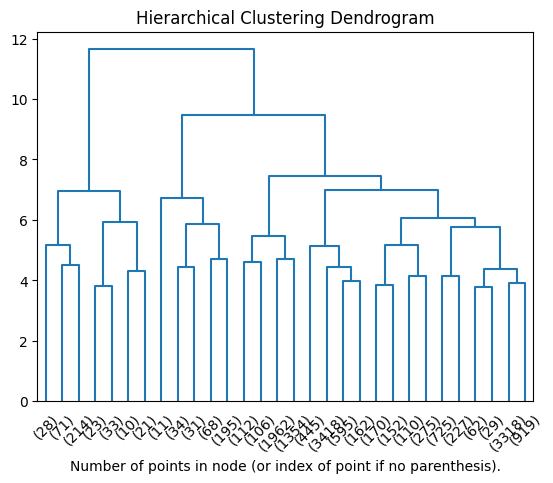

Silhouette 0.07804734070465023


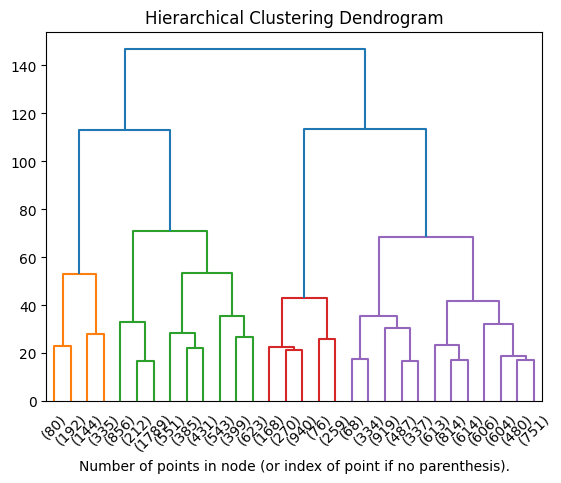

labels {0: 6540, 1: 6627, 2: 1713}
silhouette WARD 0.21003551367411796
average linkage
labels {0: 14877, 1: 2, 2: 1}
silhouette 0.493881019807609
complete linkage
labels {0: 13368, 1: 224, 2: 1288}
silhouette -0.008212116660786303


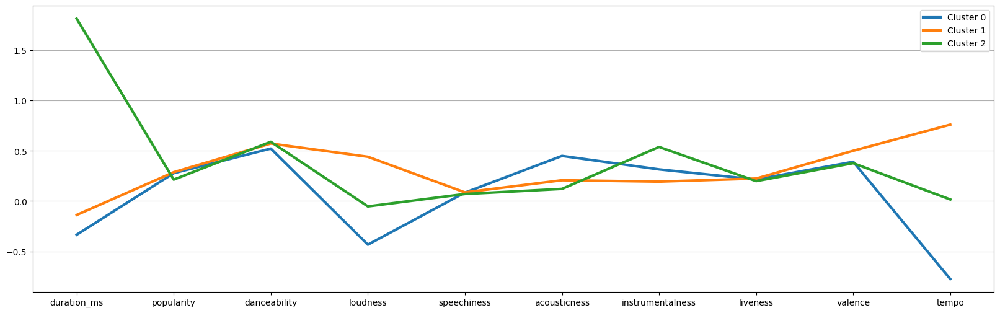

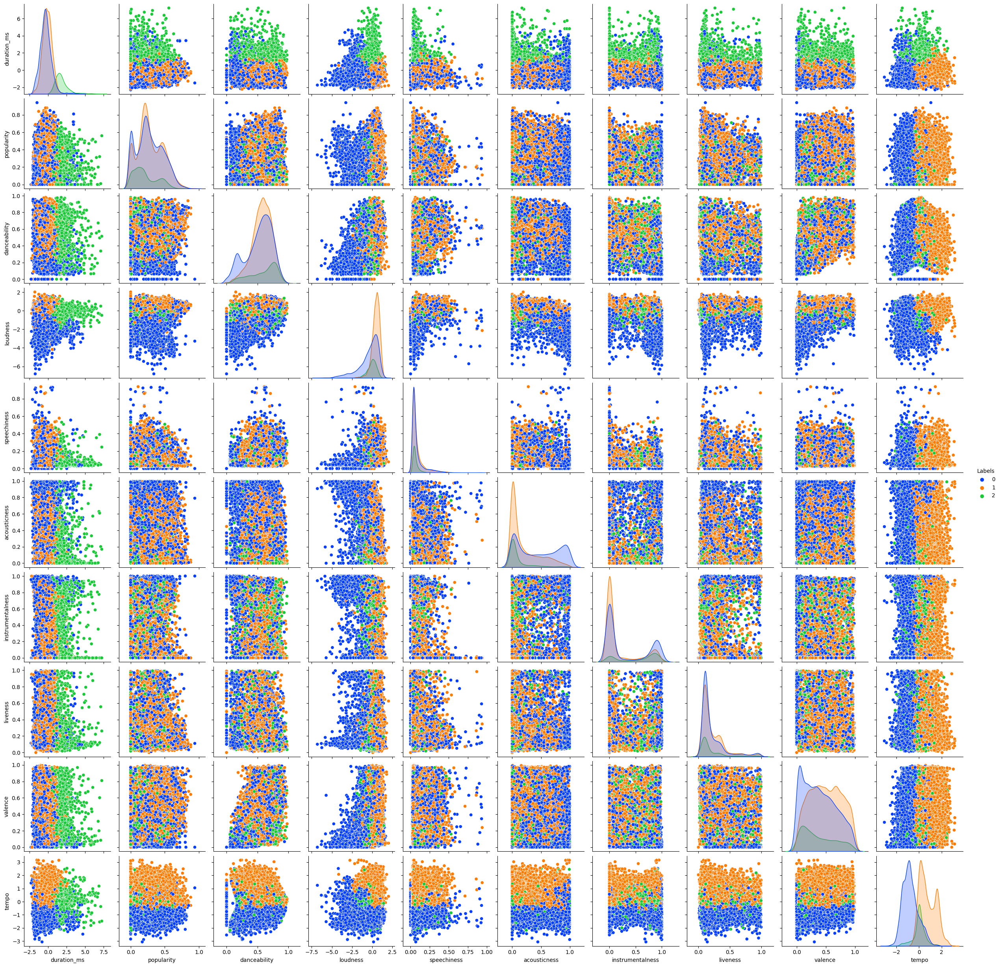

In [24]:
##### 3 cluster senza MinMaxScaler #####

import numpy as np
import pandas as pd
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from matplotlib import pyplot as plt
import seaborn as sns
from scipy.spatial.distance import pdist, squareform
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import *
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.neighbors import kneighbors_graph


df = pd.read_csv("/content/drive/MyDrive/Università/Magistrale/Data Mining/dataset (missing + split)/clustering_dataset.csv") # read the data
train_data = df.drop(['Unnamed: 0'], axis=1) # drop the first column

#df_train = df.drop(['Unnamed: 0'], axis=1) # drop the first column
#scaler = MinMaxScaler()
#train_data = scaler.fit_transform(df_train)

def get_linkage_matrix(model):
    # Create linkage matrix

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    return linkage_matrix

def plot_dendrogram(model, **kwargs):
    linkage_matrix = get_linkage_matrix(model)
    dendrogram(linkage_matrix, **kwargs)

# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(distance_threshold=0, n_clusters=None, metric='euclidean', linkage='complete')
model = model.fit(train_data)

plt.title("Hierarchical Clustering Dendrogram")
plot_dendrogram(model, truncate_mode="lastp", color_threshold=1.2)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

# get the labels according to a specific threshold value cut
Z = get_linkage_matrix(model)
labels = fcluster(Z, t=1.2, criterion='distance')
labels

print('Silhouette', silhouette_score(train_data, labels))

#hier = AgglomerativeClustering(n_clusters=3, metric='euclidean', linkage='complete')
#hier.fit(train_data)


# hierarchical clustering
# Compute the (weighted) graph of k-Neighbors for points in X
connectivity = kneighbors_graph(train_data, n_neighbors=100, include_self=False)

# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(distance_threshold=0,
                                n_clusters=None,
                                metric='euclidean',
                                linkage='ward',
                                connectivity=connectivity)

# connecet: Defines for each sample the neighboring
# samples following a given structure of the data.

model = model.fit(train_data)

plt.title("Hierarchical Clustering Dendrogram")
plot_dendrogram(model, truncate_mode="lastp")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()
############ n_cluster???????
ward = AgglomerativeClustering(n_clusters=3,
                               linkage='ward',
                               metric='euclidean',
                               connectivity=connectivity)
ward.fit(train_data)

hist, bins = np.histogram(ward.labels_, bins=range(0, len(set(ward.labels_)) + 1))
print('labels', dict(zip(bins, hist)))
print('silhouette WARD', silhouette_score(train_data, ward.labels_))

print('average linkage')
average_linkage = AgglomerativeClustering(n_clusters=3, linkage='average', metric='manhattan',  connectivity=connectivity)
average_linkage.fit(train_data)

hist, bins = np.histogram(average_linkage.labels_,
                          bins=range(0, len(set(average_linkage.labels_)) + 1))

print('labels', dict(zip(bins, hist)))
print('silhouette', silhouette_score(train_data, average_linkage.labels_))


print('complete linkage')
complete_linkage = AgglomerativeClustering(n_clusters=3, linkage='complete', metric='l1', connectivity=connectivity)
complete_linkage.fit(train_data)

hist, bins = np.histogram(complete_linkage.labels_,
                          bins=range(0, len(set(complete_linkage.labels_)) + 1))

print('labels', dict(zip(bins, hist)))
print('silhouette', silhouette_score(train_data, complete_linkage.labels_))



#grafico a linee orizzontali
cluster_labels = ward.labels_

# Plot the cluster centers
plt.figure(figsize=(20, 6))
n_clusters = 3
for i in range(n_clusters):
    plt.plot(range(0, len(df_train.columns)), df_train.iloc[cluster_labels == i].mean(), label='Cluster %s' % i, linewidth=3)

plt.xticks(range(0, len(df_train.columns)), list(df_train.columns))
plt.legend(bbox_to_anchor=(1, 1))
plt.grid(axis='y')
plt.show()

# Pairplot
df_clusters = df_train.copy()
df_clusters['Labels'] = ward.labels_

# Utilizza seaborn per visualizzare il pairplot con Hue sui valori di Ward
sns.pairplot(df_clusters, hue='Labels', palette='bright')
plt.show()

#scatterplot
#df_clusters = df_train.copy()
#df_clusters['Labels'] = ward.labels_
#for i in range(len(df_clusters.columns)):
#    for j in range(i + 1, len(df_clusters.columns)):
#        sns.scatterplot(data=df_clusters, x=df_clusters.columns[i], y=df_clusters.columns[j], hue=ward.labels_, style=ward.labels_, palette="bright")
#        plt.show()


In [ ]:
##### 3 cluster con MinMaxScaler #####

import numpy as np
import pandas as pd
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from matplotlib import pyplot as plt
import seaborn as sns
from scipy.spatial.distance import pdist, squareform
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import *
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.neighbors import kneighbors_graph


df = pd.read_csv("/content/drive/MyDrive/Università/Magistrale/Data Mining/dataset (missing + split)/clustering_dataset.csv") # read the data
#train_data = df.drop(['Unnamed: 0'], axis=1) # drop the first column

df_train = df.drop(['Unnamed: 0'], axis=1) # drop the first column
scaler = MinMaxScaler()
train_data = scaler.fit_transform(df_train)

def get_linkage_matrix(model):
    # Create linkage matrix

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    return linkage_matrix

def plot_dendrogram(model, **kwargs):
    linkage_matrix = get_linkage_matrix(model)
    dendrogram(linkage_matrix, **kwargs)

# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(distance_threshold=0, n_clusters=None, metric='euclidean', linkage='complete')
model = model.fit(train_data)

plt.title("Hierarchical Clustering Dendrogram")
plot_dendrogram(model, truncate_mode="lastp", color_threshold=1.2)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

# get the labels according to a specific threshold value cut
Z = get_linkage_matrix(model)
labels = fcluster(Z, t=1.2, criterion='distance')
labels

print('Silhouette', silhouette_score(train_data, labels))

#hier = AgglomerativeClustering(n_clusters=3, metric='euclidean', linkage='complete')
#hier.fit(train_data)


# hierarchical clustering
# Compute the (weighted) graph of k-Neighbors for points in X
connectivity = kneighbors_graph(train_data, n_neighbors=100, include_self=False)

# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(distance_threshold=0,
                                n_clusters=None,
                                metric='euclidean',
                                linkage='ward',
                                connectivity=connectivity)

# connecet: Defines for each sample the neighboring
# samples following a given structure of the data.

model = model.fit(train_data)

plt.title("Hierarchical Clustering Dendrogram")
plot_dendrogram(model, truncate_mode="lastp")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()
############ n_cluster???????
ward = AgglomerativeClustering(n_clusters=3,
                               linkage='ward',
                               metric='euclidean',
                               connectivity=connectivity)
ward.fit(train_data)

hist, bins = np.histogram(ward.labels_, bins=range(0, len(set(ward.labels_)) + 1))
print('labels', dict(zip(bins, hist)))
print('silhouette WARD', silhouette_score(train_data, ward.labels_))

print('average linkage')
average_linkage = AgglomerativeClustering(n_clusters=3, linkage='average', metric='manhattan',  connectivity=connectivity)
average_linkage.fit(train_data)

hist, bins = np.histogram(average_linkage.labels_,
                          bins=range(0, len(set(average_linkage.labels_)) + 1))

print('labels', dict(zip(bins, hist)))
print('silhouette', silhouette_score(train_data, average_linkage.labels_))


print('complete linkage')
complete_linkage = AgglomerativeClustering(n_clusters=3, linkage='complete', metric='l1', connectivity=connectivity)
complete_linkage.fit(train_data)

hist, bins = np.histogram(complete_linkage.labels_,
                          bins=range(0, len(set(complete_linkage.labels_)) + 1))

print('labels', dict(zip(bins, hist)))
print('silhouette', silhouette_score(train_data, complete_linkage.labels_))



#grafico a linee orizzontali
cluster_labels = ward.labels_

# Plot the cluster centers
plt.figure(figsize=(20, 6))
n_clusters = 3
for i in range(n_clusters):
    plt.plot(range(0, len(df_train.columns)), df_train.iloc[cluster_labels == i].mean(), label='Cluster %s' % i, linewidth=3)

plt.xticks(range(0, len(df_train.columns)), list(df_train.columns))
plt.legend(bbox_to_anchor=(1, 1))
plt.grid(axis='y')
plt.show()

# Pairplot
df_clusters = df_train.copy()
df_clusters['Labels'] = ward.labels_

# Utilizza seaborn per visualizzare il pairplot con Hue sui valori di Ward
sns.pairplot(df_clusters, hue='Labels', palette='bright')
plt.show()

#scatterplot
#df_clusters = df_train.copy()
#df_clusters['Labels'] = ward.labels_
#for i in range(len(df_clusters.columns)):
#    for j in range(i + 1, len(df_clusters.columns)):
#        sns.scatterplot(data=df_clusters, x=df_clusters.columns[i], y=df_clusters.columns[j], hue=ward.labels_, style=ward.labels_, palette="bright")
#        plt.show()
